In [1]:
import cv2

In [2]:
# Two images
img1 = cv2.imread('../DATA/dog_backpack.png')
img2 = cv2.imread('../DATA/watermark_no_copy.png')

In [3]:
import matplotlib.pyplot as plt
%matplotlib inline

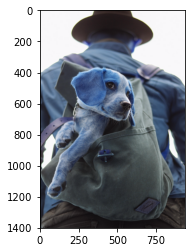

In [4]:
plt.imshow(img1)

In [5]:
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

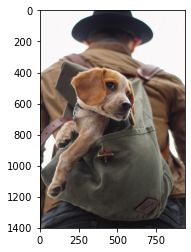

In [6]:
plt.imshow(img1)

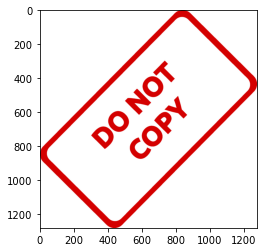

In [7]:
plt.imshow(img2)

In [8]:
img1 =cv2.resize(img1,(1200,1200))
img2 =cv2.resize(img2,(1200,1200))

In [9]:
blended=cv2.addWeighted(img1,0.5,img2,0.5,0)

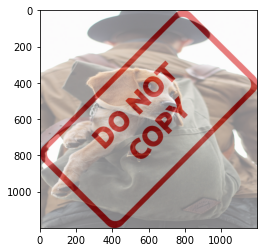

In [10]:
plt.imshow(blended)

In [11]:
# Load two images
img1 = cv2.imread('../DATA/dog_backpack.png')
img2 = cv2.imread('../DATA/watermark_no_copy.png')
img2 =cv2.resize(img2,(600,600))

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

large_img = img1
small_img = img2

In [12]:
large_img[0:small_img.shape[0],0:small_img.shape[1]] = small_img

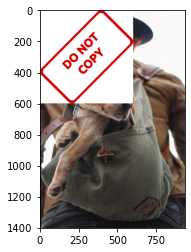

In [13]:
plt.imshow(large_img)

In [14]:
# Load two images
img1 = cv2.imread('../DATA/dog_backpack.png')
img2 = cv2.imread('../DATA/watermark_no_copy.png')
img2 =cv2.resize(img2,(600,600))

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

In [15]:
#CREATE REGION OF INTEREST

In [16]:
img1.shape

(1401, 934, 3)

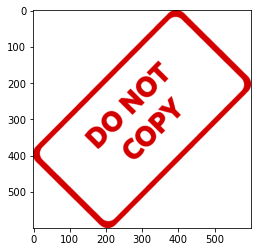

In [151]:
img2.shape
plt.imshow(img2)

In [18]:
y_offset=(img1.shape)[0]-(img2.shape)[0]
x_offset=(img1.shape)[1]-(img2.shape)[1]

In [19]:
print(x_offset,y_offset)

334 801


In [20]:
# Creating an ROI of the same size of the foreground image (smaller image that will go on top)
rows,cols,channels = img2.shape
# roi = img1[0:rows, 0:cols ] # TOP LEFT CORNER
roi = img1[y_offset:1401,x_offset:943] # BOTTOM RIGHT CORNER

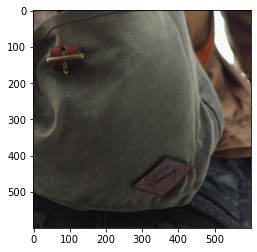

In [21]:
plt.imshow(roi)

In [22]:
roi.shape

(600, 600, 3)

In [23]:
# Now create a mask of logo and create its inverse mask also
img2gray = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY)

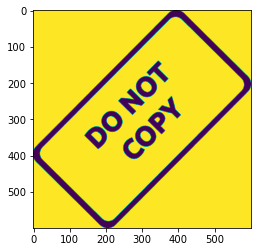

In [24]:
plt.imshow(img2gray)

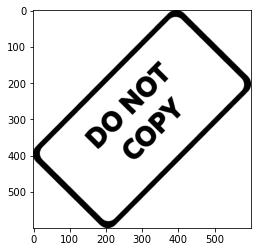

In [25]:
plt.imshow(img2gray,cmap='gray')

In [26]:
mask_inv=cv2.bitwise_not(img2gray)

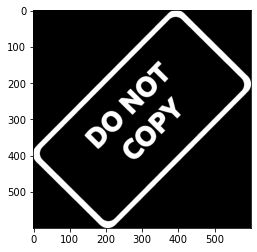

In [27]:
plt.imshow(mask_inv,cmap='gray')

In [28]:
import numpy as np
white_background=np.full(img2.shape,255,dtype=np.uint8)

In [29]:
print(white_background.shape)
white_background

(600, 600, 3)


array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]

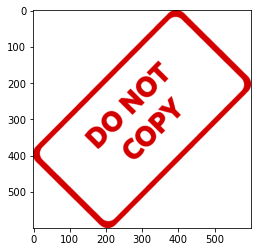

In [30]:
plt.imshow(img2,cmap='gray')

In [31]:
bk = cv2.bitwise_or(white_background, white_background, mask=mask_inv)
bk

array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)

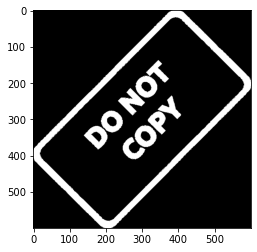

In [32]:
plt.imshow(bk)

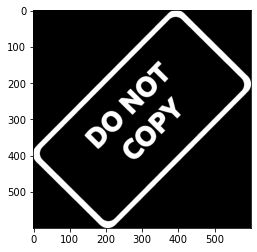

In [33]:
plt.imshow(mask_inv,cmap='gray')

In [34]:
fg = cv2.bitwise_or(img2, img2, mask=mask_inv)

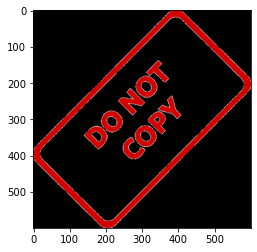

In [35]:
plt.imshow(fg)

In [36]:
final_roi = cv2.bitwise_or(roi,fg)

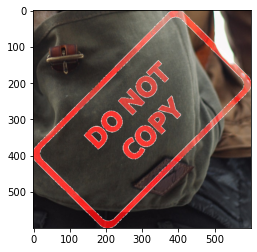

In [37]:
plt.imshow(final_roi)

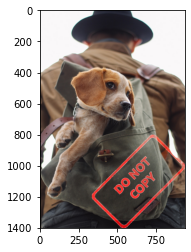

In [38]:
large_img = img1
small_img = final_roi


large_img[y_offset:y_offset+small_img.shape[0], x_offset:x_offset+small_img.shape[1]] = small_img

plt.imshow(large_img)

# Image Thresholding

In [39]:
img = cv2.imread('../DATA/rainbow.jpg')

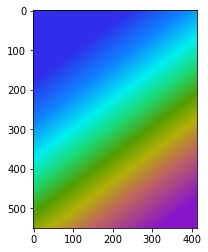

In [40]:
plt.imshow(img)

In [41]:
# Adding the 0 flag to read it in black and white
img = cv2.imread('../DATA/rainbow.jpg',0)

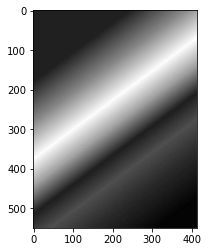

In [42]:
plt.imshow(img,cmap='gray')

In [43]:
ret,thresh1=cv2.threshold(img,127,255,cv2.THRESH_BINARY)

In [44]:
ret

127.0

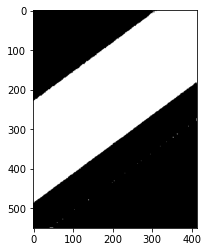

In [45]:
plt.imshow(thresh1,cmap='gray')

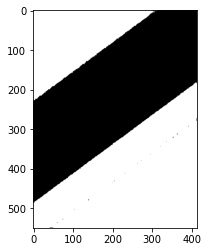

In [46]:
ret,thresh2 = cv2.threshold(img,127,255,cv2.THRESH_BINARY_INV)
plt.imshow(thresh2,cmap='gray')

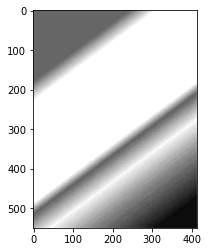

In [47]:
ret,thresh3 = cv2.threshold(img,127,255,cv2.THRESH_TRUNC)
plt.imshow(thresh3,cmap='gray')

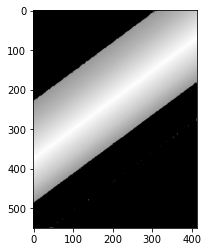

In [48]:
ret,thresh4 = cv2.threshold(img,127,255,cv2.THRESH_TOZERO)
plt.imshow(thresh4,cmap='gray')

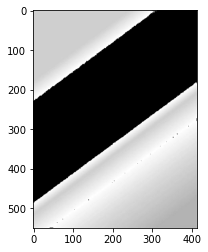

In [49]:
ret,thresh5 = cv2.threshold(img,127,255,cv2.THRESH_TOZERO_INV)
plt.imshow(thresh5,cmap='gray')

In [50]:
img = cv2.imread("../DATA/crossword.jpg",0)

In [51]:
def show_pic(img):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap='gray')

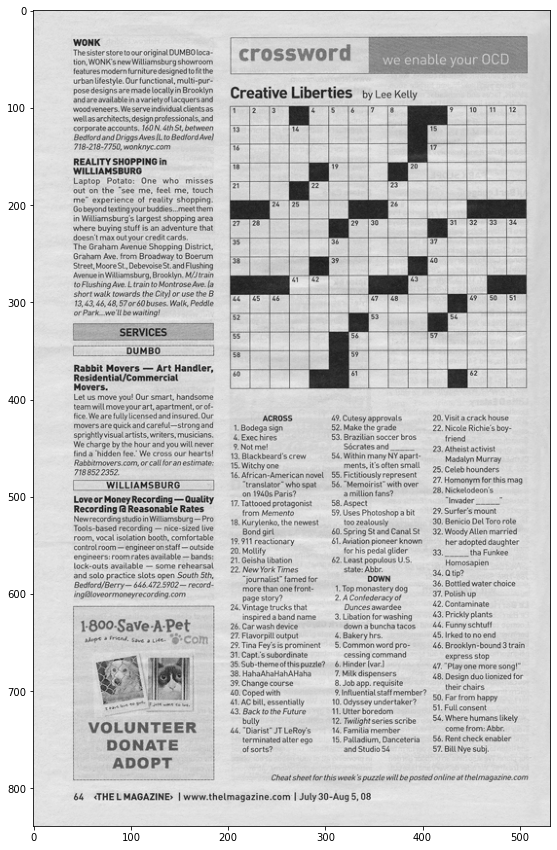

In [52]:
show_pic(img)

In [53]:
ret,th1 = cv2.threshold(img,157,255,cv2.THRESH_BINARY)

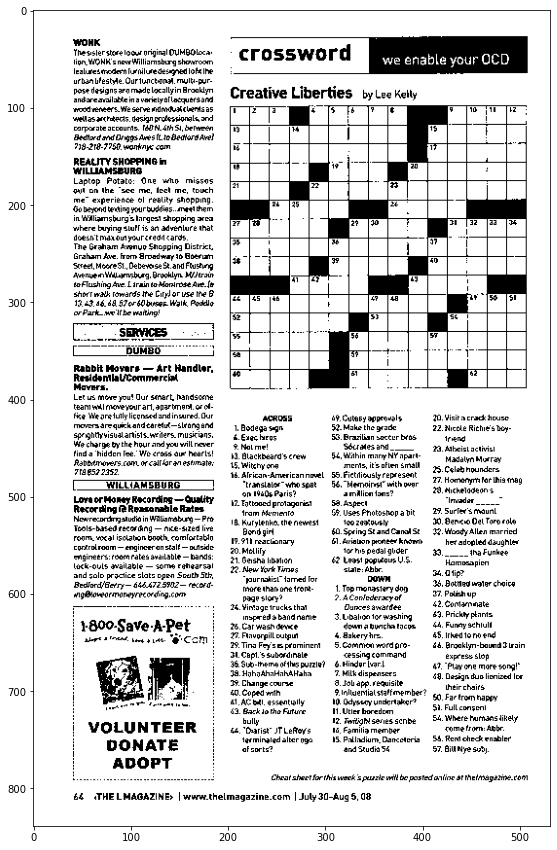

In [54]:
show_pic(th1)

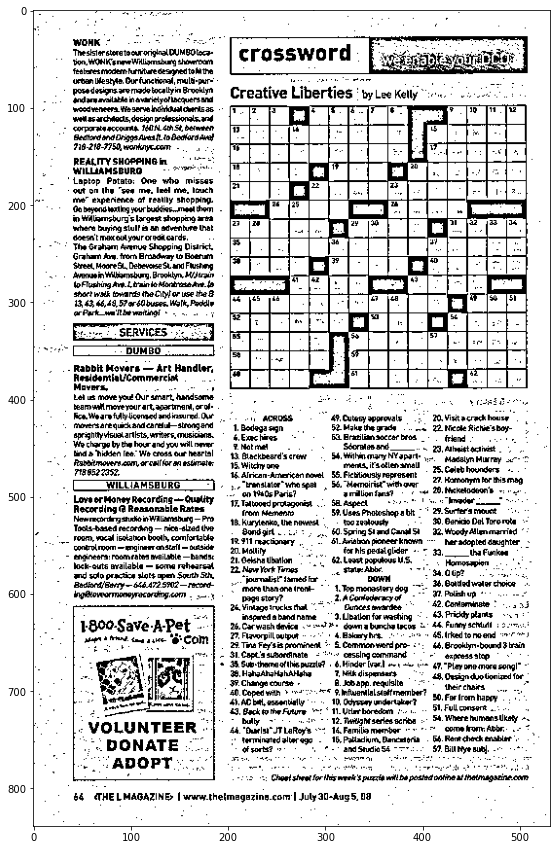

In [55]:
th2 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_MEAN_C,cv2.THRESH_BINARY,11,8) # Play around with these last 2 numbers
show_pic(th2)

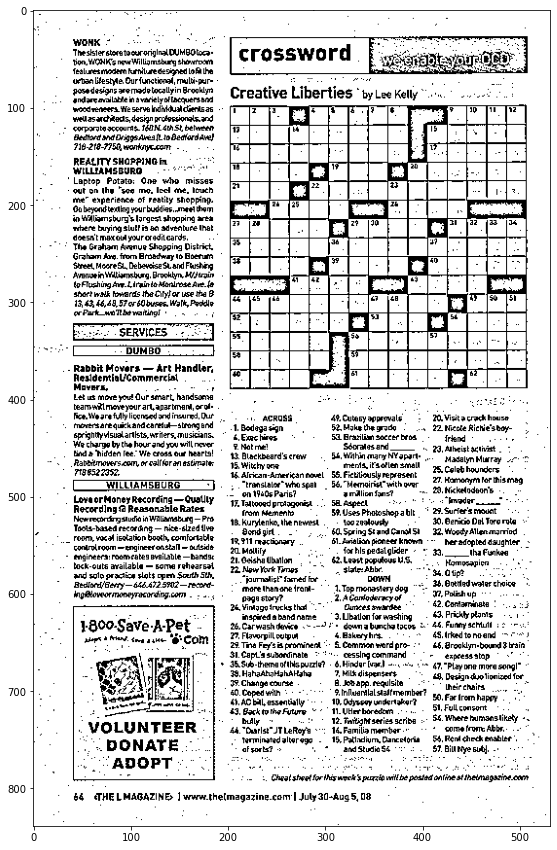

In [56]:
th3 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,15,8)
show_pic(th3)

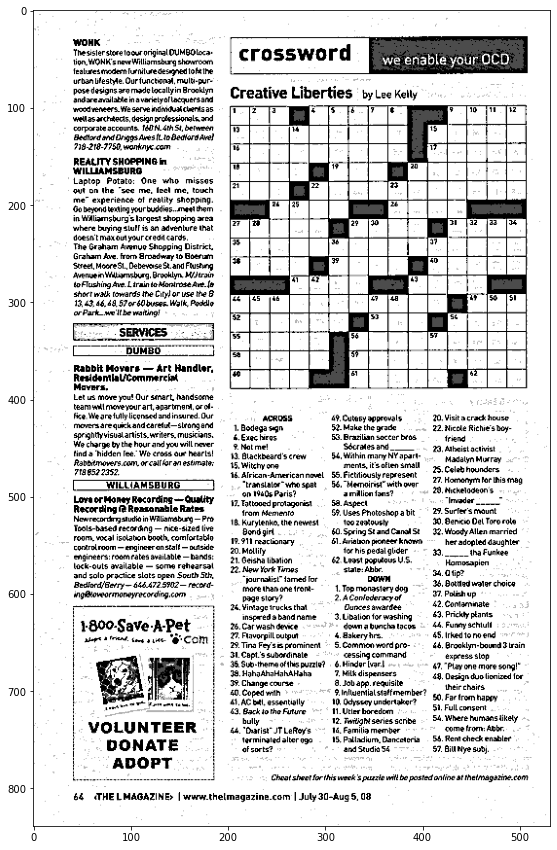

In [57]:
blended = cv2.addWeighted(src1=th1,alpha=0.7,src2=th2,beta=0.3,gamma=0)
show_pic(blended)

# Blurring and Smoothing

There are a lot of different effects and filters we can apply to images. We're just going to go through a few of them here. Most of them involve some sort of math based function being applied to all the pixels values.


-----
#### Info Link on Blurring Math:

http://people.csail.mit.edu/sparis/bf_course/

------

## Convenience Functions

Quick function for loading the puppy image.

In [58]:
def load_img():
    img = cv2.imread('../DATA/bricks.jpg').astype(np.float32) / 255
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img

In [59]:
def display_img(img):
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_subplot(111)
    ax.imshow(img)

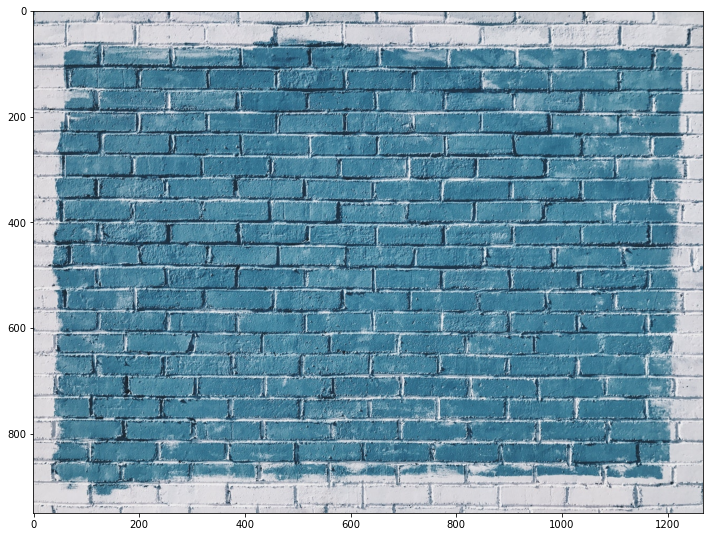

In [60]:
i = load_img()
display_img(i)

### Gamma Correction : Practical Effect of Increasing Brightness

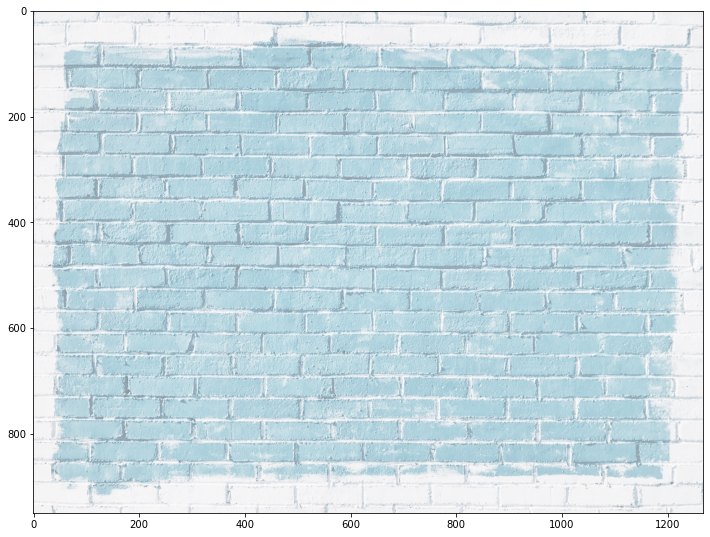

In [61]:
img = load_img()
gamma = 1/4
effected_image = np.power(img, gamma)
display_img(effected_image)

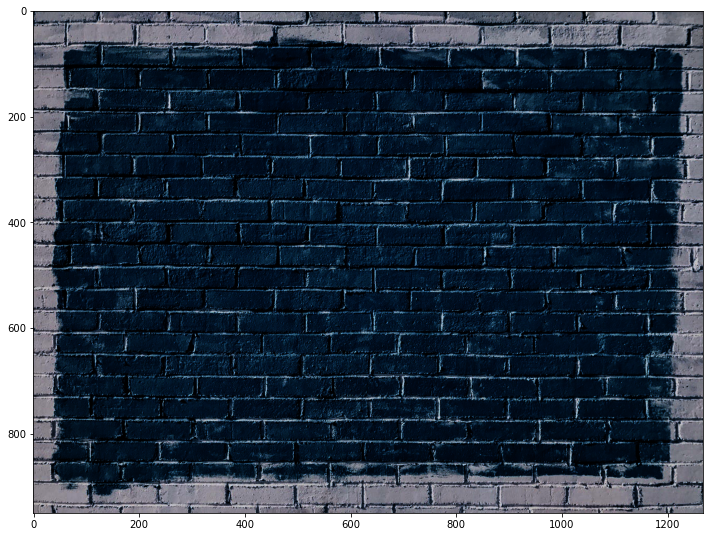

In [62]:
img = load_img()
gamma = 4
effected_image = np.power(img, gamma)
display_img(effected_image)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


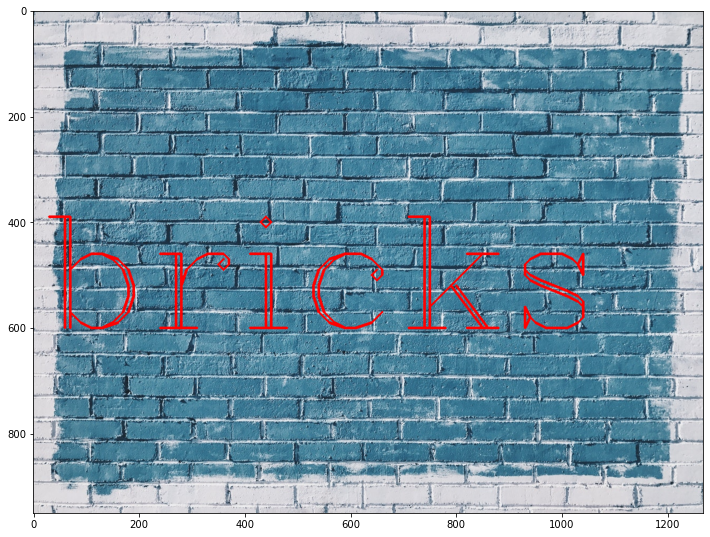

In [63]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks',org=(10,600), fontFace=font,fontScale= 10,color=(255,0,0),thickness=4)
display_img(img)

In [64]:
kernel = np.ones(shape=(5,5),dtype=np.float32)/25

In [65]:
kernel

array([[0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04]], dtype=float32)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


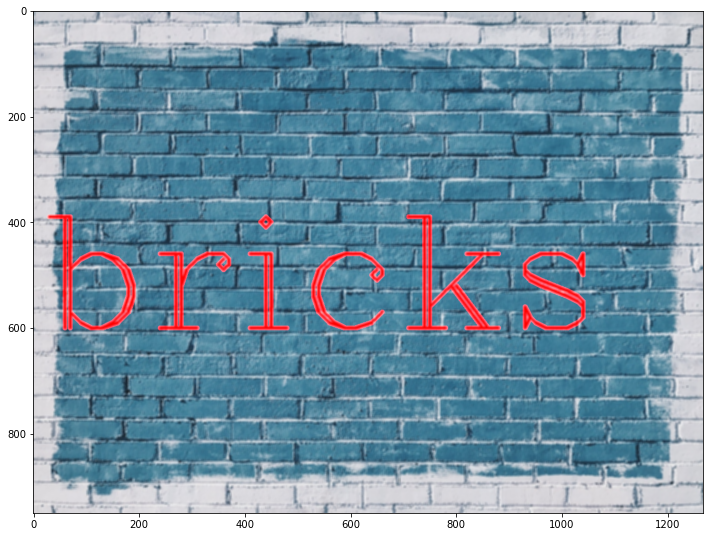

In [66]:
dst = cv2.filter2D(img,-1,kernel)
display_img(dst)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


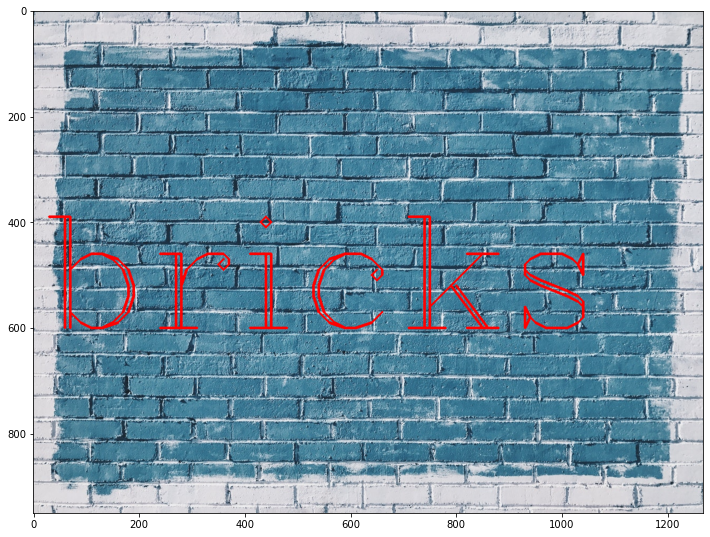

In [67]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks',org=(10,600), fontFace=font,fontScale= 10,color=(255,0,0),thickness=4)
display_img(img)

In [68]:
blurred_img = cv2.blur(img,ksize=(5,5))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


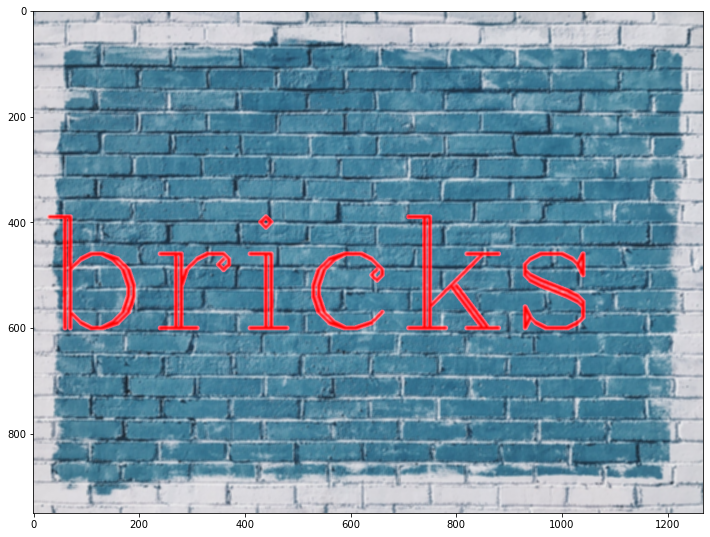

In [69]:
display_img(blurred_img)

## Gaussian Blurring

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


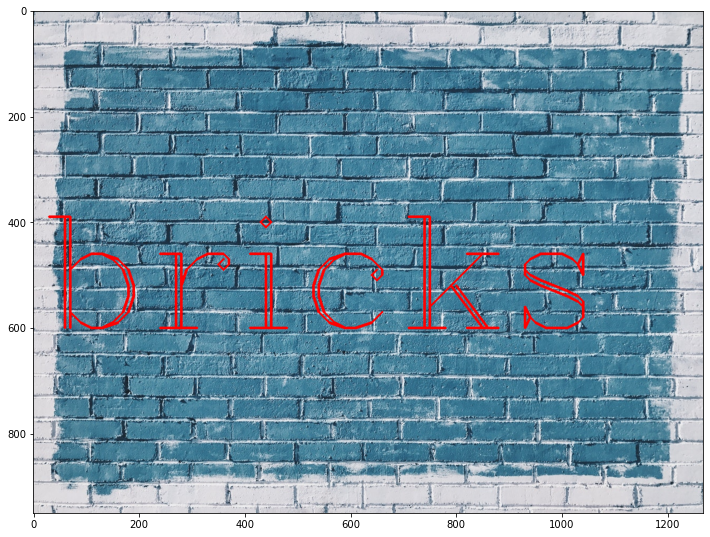

In [70]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks',org=(10,600), fontFace=font,fontScale= 10,color=(255,0,0),thickness=4)
display_img(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


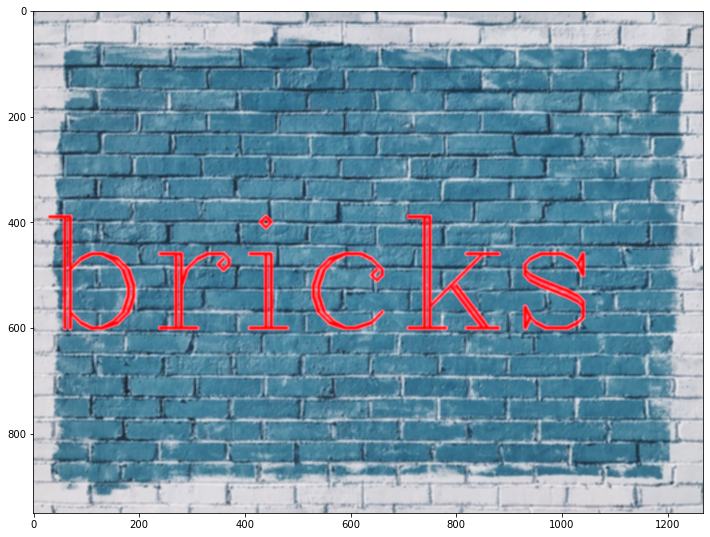

In [71]:
blurred_img=cv2.GaussianBlur(img,(5,5),10)
display_img(blurred_img)

## Median Blurring

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


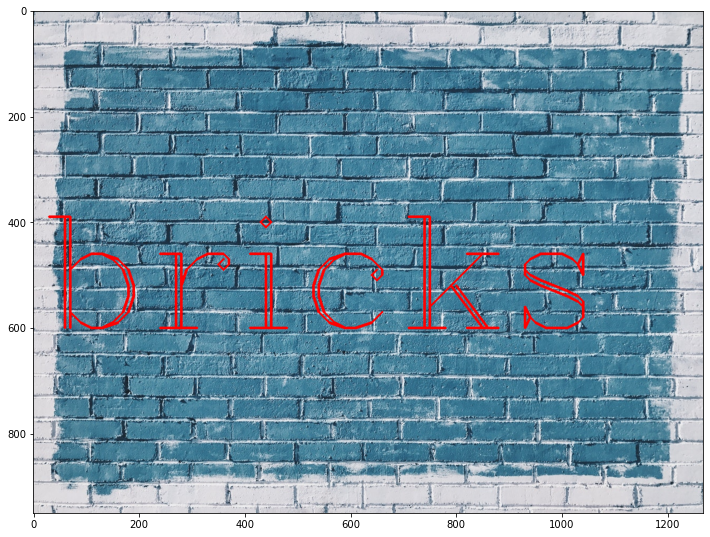

In [72]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks',org=(10,600), fontFace=font,fontScale= 10,color=(255,0,0),thickness=4)
display_img(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


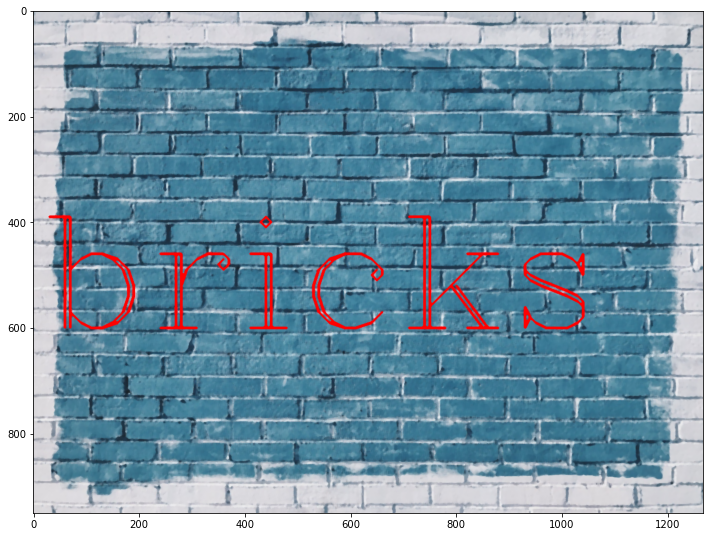

In [73]:
median = cv2.medianBlur(img,5)
display_img(median)

----------
### Adding Noise

Let's see a more useful case of Median Blurring by adding some random noise to an image.

In [74]:
img = cv2.imread('../DATA/sammy.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

In [75]:
img.mean()

89.33240744375256

In [76]:
img.shape

(1367, 1025, 3)

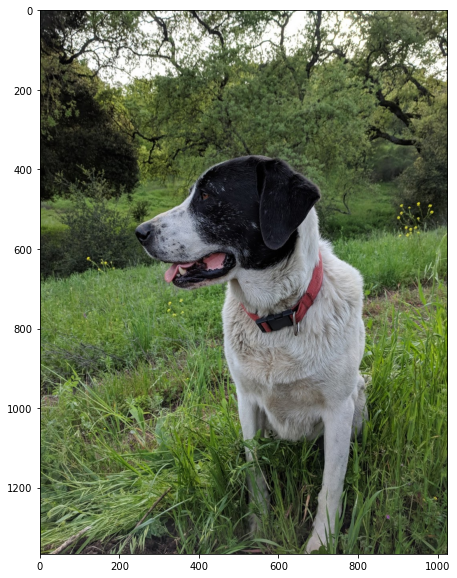

In [77]:
display_img(img)

In [78]:
noise_img = cv2.imread('../DATA/sammy_noise.jpg')

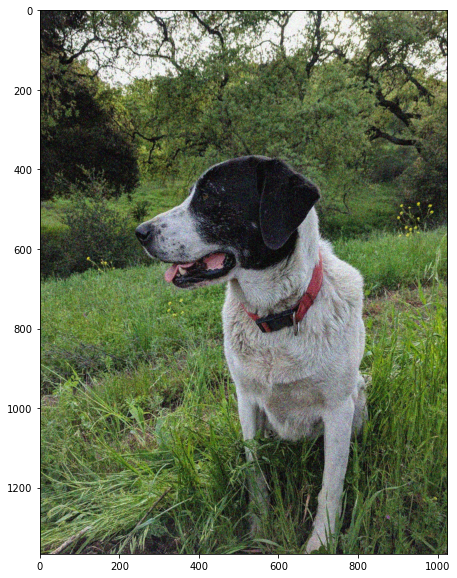

In [79]:
display_img(noise_img)

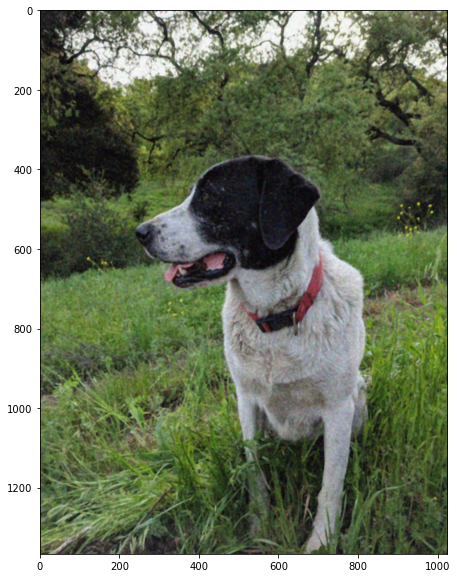

In [80]:
median = cv2.medianBlur(noise_img,5)
display_img(median)

## Bilateral Filtering

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


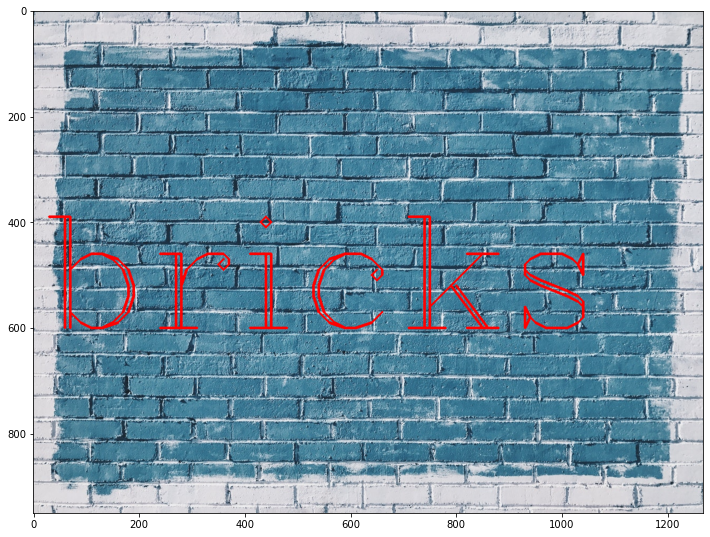

In [81]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks',org=(10,600), fontFace=font,fontScale= 10,color=(255,0,0),thickness=4)
display_img(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


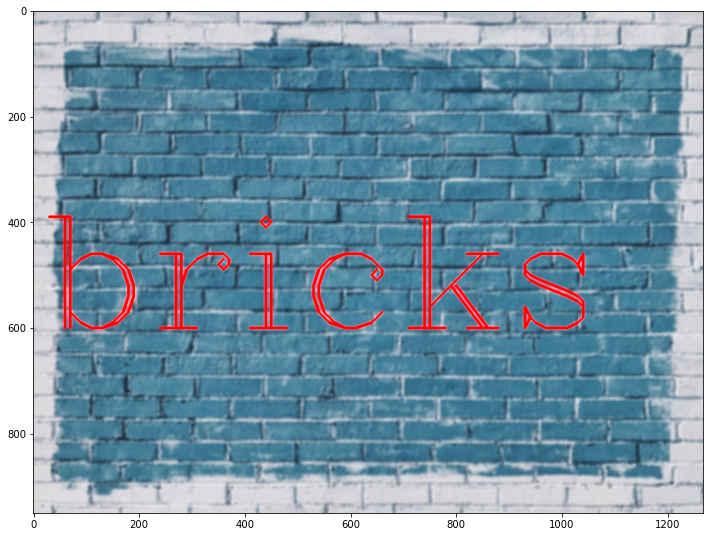

In [82]:
blur = cv2.bilateralFilter(img,9,75,75)
display_img(blur)

In [83]:
def load_img():
    blank_img =np.zeros((600,600))
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(blank_img,text='ABCDE',org=(50,300), fontFace=font,fontScale= 5,color=(255,255,255),thickness=25,lineType=cv2.LINE_AA)
    return blank_img

In [84]:
def display_img(img):
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap='gray')

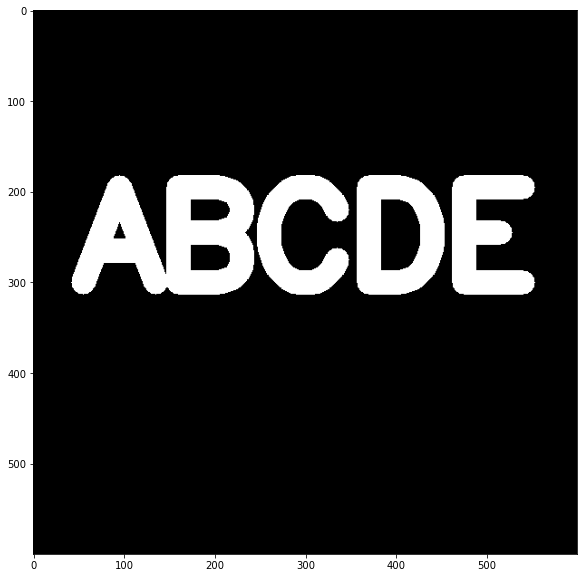

In [85]:
img = load_img()
display_img(img)


Erodes away boundaries of foreground objects. Works best when foreground is light color (preferrably white) and background is dark.

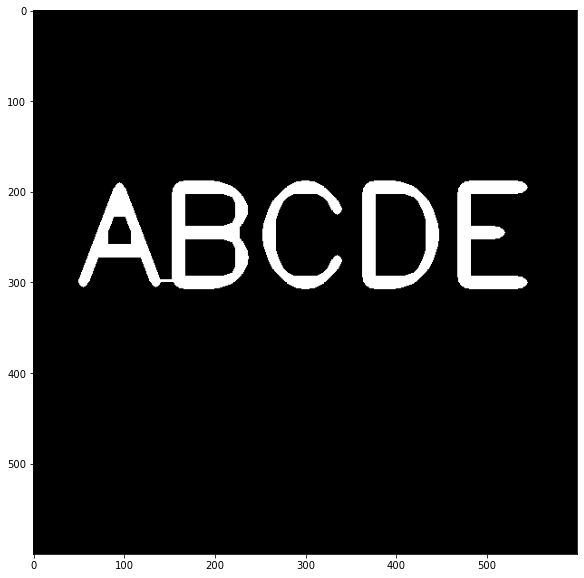

In [86]:
kernel=np.ones((5,5),np.uint8)
erosion1=cv2.erode(img,kernel,iterations=3)
display_img(erosion1)

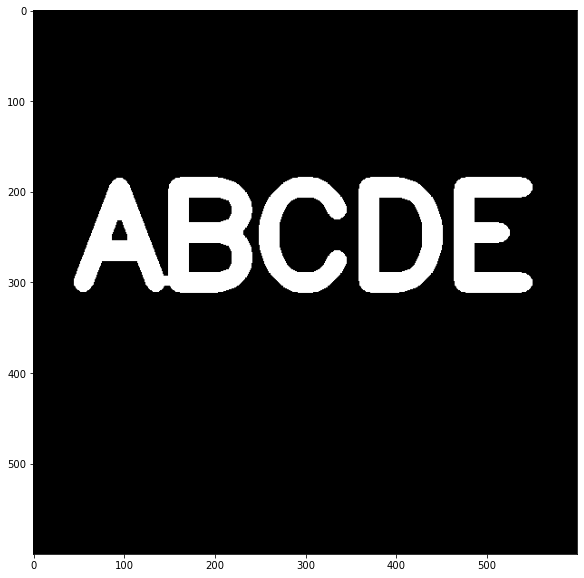

In [87]:
kernel=np.ones((5,5),np.uint8)
erosion1=cv2.erode(img,kernel,iterations=1)
display_img(erosion1)

## Opening
Opening is erosion followed by dilation. Useful in removing background noise!

In [88]:
img = load_img()
white_noise = np.random.randint(low=0,high=2,size=(600,600))
white_noise

array([[1, 0, 1, ..., 1, 0, 1],
       [0, 0, 1, ..., 0, 0, 0],
       [0, 0, 1, ..., 1, 1, 0],
       ...,
       [0, 1, 0, ..., 1, 1, 1],
       [1, 1, 0, ..., 0, 0, 0],
       [1, 0, 1, ..., 0, 0, 1]])

In [89]:
white_noise = white_noise*255
white_noise.shape

(600, 600)

In [90]:
img.shape

(600, 600)

In [91]:
noise_img = white_noise+img

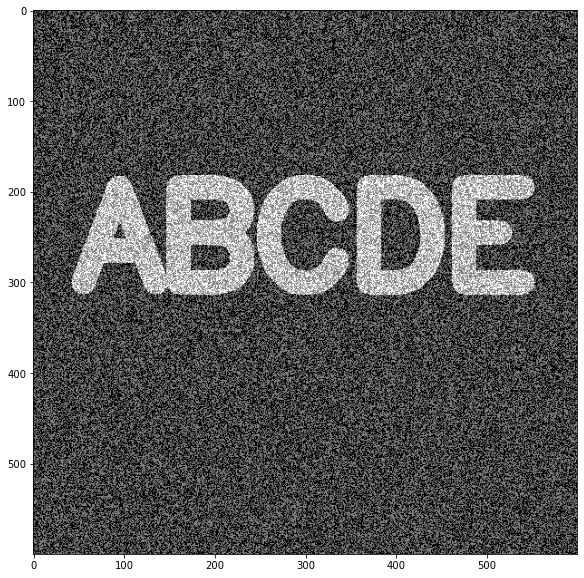

In [92]:
display_img(noise_img)

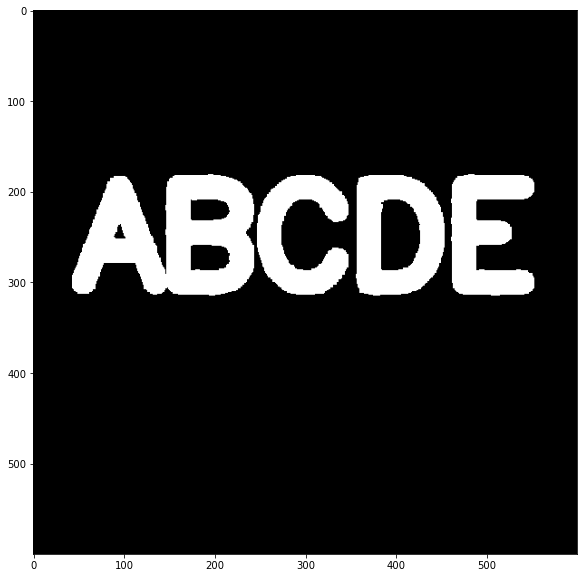

In [93]:
opening = cv2.morphologyEx(noise_img, cv2.MORPH_OPEN, kernel)
display_img(opening)

### Closing
 Useful in removing noise from foreground objects, such as black dots on top of the white text.

In [94]:
img = load_img()
black_noise = np.random.randint(low=0,high=2,size=(600,600))
black_noise

array([[1, 0, 1, ..., 1, 1, 1],
       [1, 1, 0, ..., 1, 0, 0],
       [1, 0, 0, ..., 0, 1, 0],
       ...,
       [1, 1, 0, ..., 1, 0, 1],
       [0, 0, 0, ..., 0, 1, 1],
       [0, 0, 0, ..., 1, 0, 1]])

In [95]:
black_noise= black_noise * -255

In [96]:
black_noise_img = img + black_noise

In [97]:
black_noise_img

array([[-255.,    0., -255., ..., -255., -255., -255.],
       [-255., -255.,    0., ..., -255.,    0.,    0.],
       [-255.,    0.,    0., ...,    0., -255.,    0.],
       ...,
       [-255., -255.,    0., ..., -255.,    0., -255.],
       [   0.,    0.,    0., ...,    0., -255., -255.],
       [   0.,    0.,    0., ..., -255.,    0., -255.]])

In [98]:
black_noise_img[black_noise_img==-255] = 0

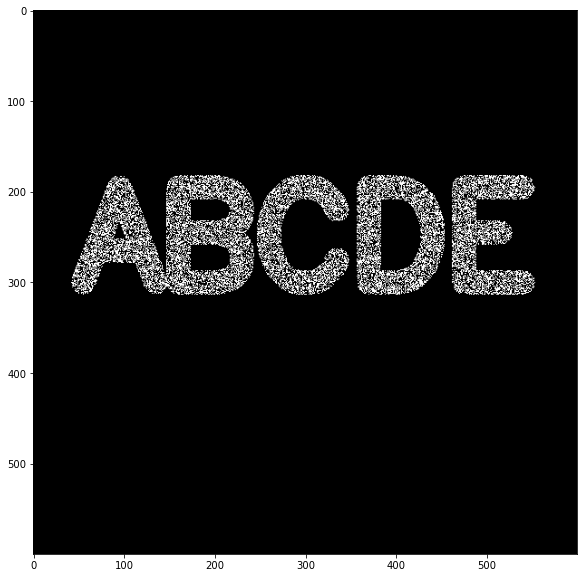

In [99]:
display_img(black_noise_img)

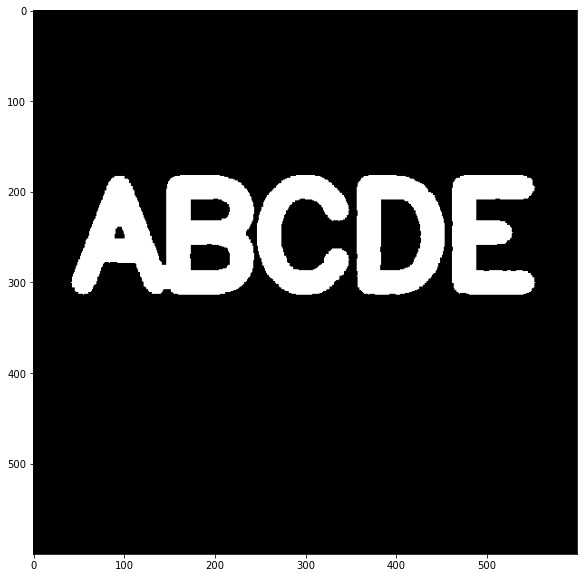

In [100]:
closing = cv2.morphologyEx(black_noise_img, cv2.MORPH_CLOSE, kernel)
display_img(closing)

## Morphological Gradient

Difference between dilation and erosion of an image.

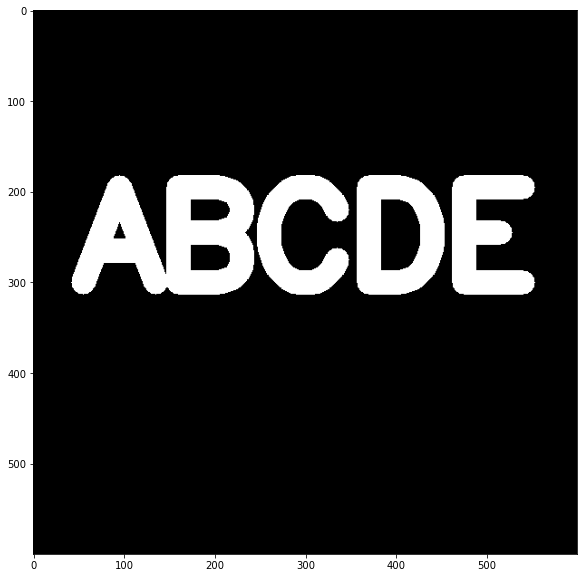

In [101]:
img = load_img()
display_img(img)

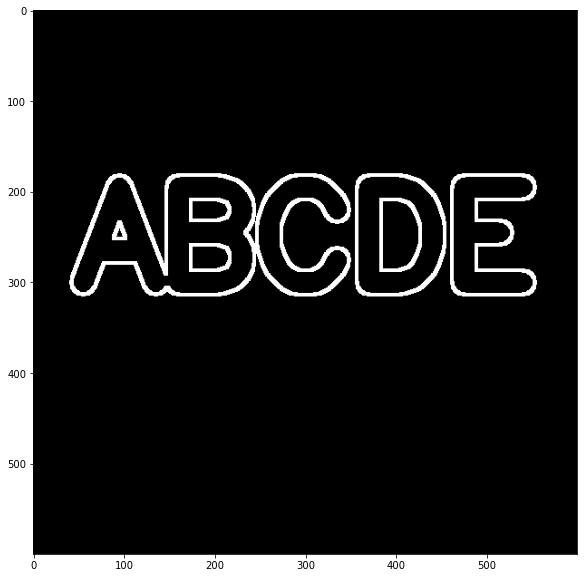

In [102]:
gradient = cv2.morphologyEx(img,cv2.MORPH_GRADIENT,kernel)
display_img(gradient)

# Gradients

Understanding gradients will allow us to eventually understand edge detection which we will use later on, since its an important aspect of object detection in general.
Make sure to watch the lecture video for the full overview!

In [103]:
img = cv2.imread('../DATA/sudoku.jpg',0)

In [104]:
def display_img(img):
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap='gray')

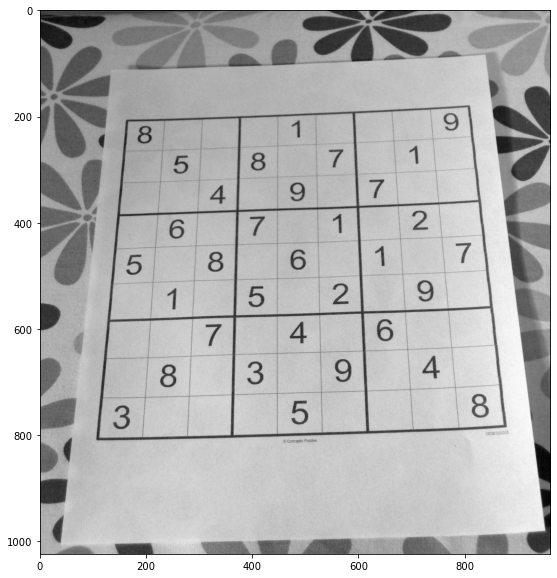

In [105]:
display_img(img)

In [106]:
sobelx = cv2.Sobel(img,cv2.CV_64F,1,0,ksize=5)
sobely = cv2.Sobel(img,cv2.CV_64F,0,1,ksize=5)
laplacian = cv2.Laplacian(img,cv2.CV_64F)

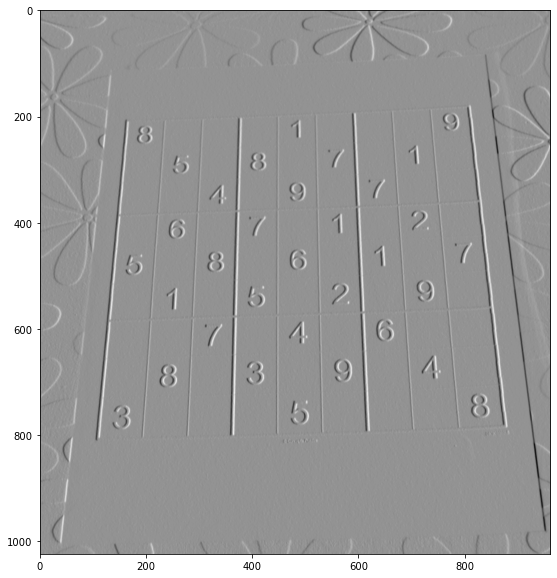

In [107]:
display_img(sobelx)

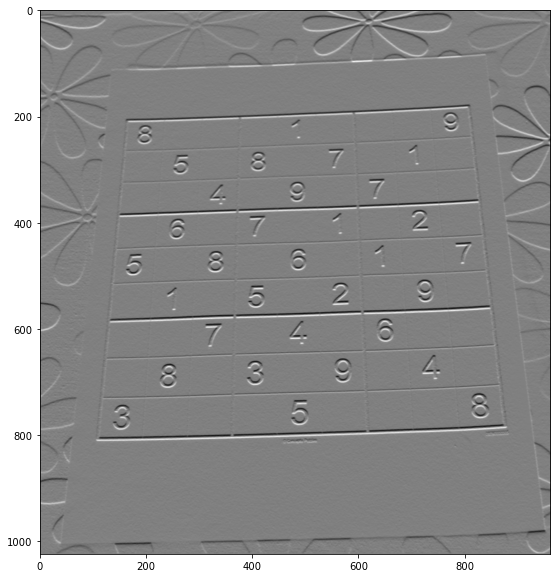

In [108]:
display_img(sobely)

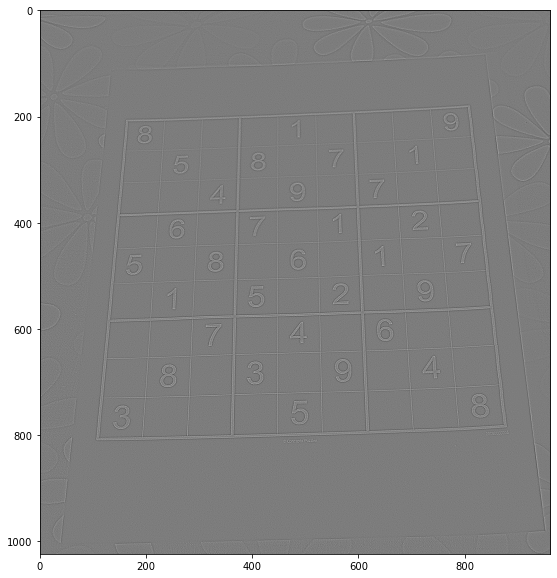

In [109]:
display_img(laplacian)

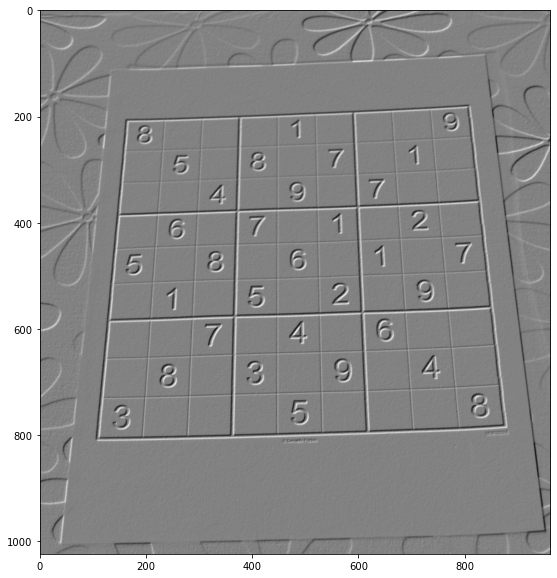

In [110]:
blended = cv2.addWeighted(src1=sobelx,alpha=0.5,src2=sobely,beta=0.5,gamma=0)
display_img(blended)

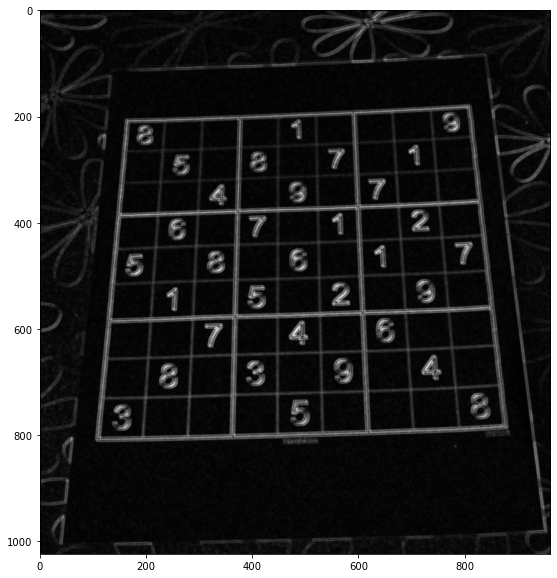

In [111]:
kernel = np.ones((4,4),np.uint8)
gradient = cv2.morphologyEx(blended,cv2.MORPH_GRADIENT,kernel)
display_img(gradient)

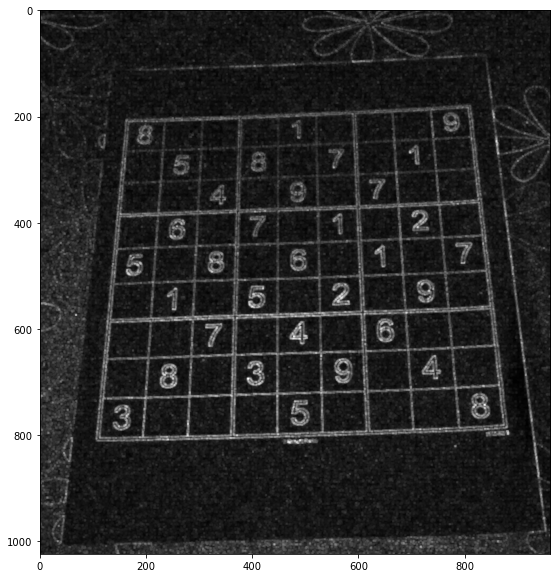

In [112]:
kernel = np.ones((4,4),np.uint8)
gradient = cv2.morphologyEx(laplacian,cv2.MORPH_GRADIENT,kernel)
display_img(gradient)

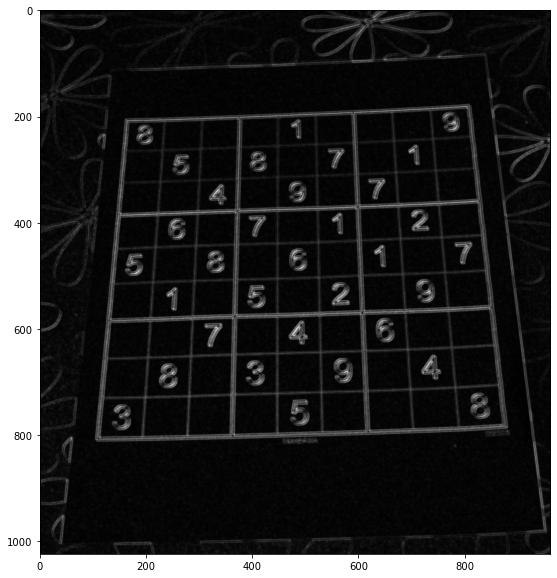

In [113]:
kernel = np.ones((3,3),np.uint8)
gradient = cv2.morphologyEx(blended,cv2.MORPH_GRADIENT,kernel)
display_img(gradient)

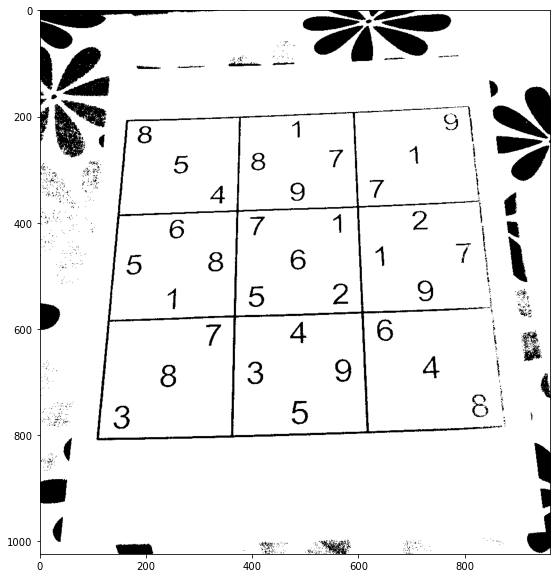

In [114]:
ret,th1 = cv2.threshold(img,100,255,cv2.THRESH_BINARY)
display_img(th1)

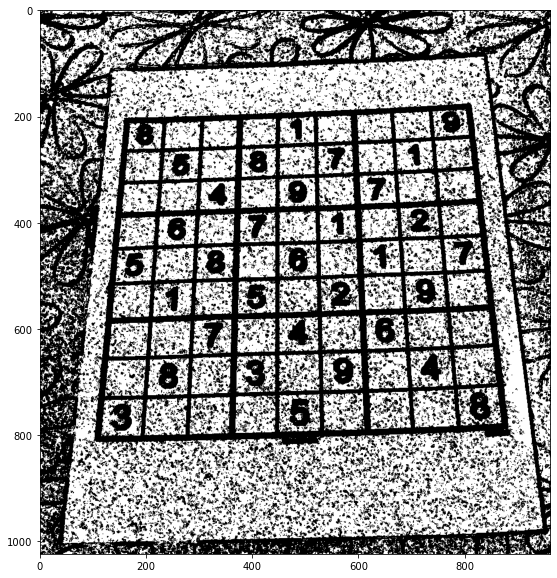

In [115]:
ret,th1 = cv2.threshold(gradient,200,255,cv2.THRESH_BINARY_INV)
display_img(th1)

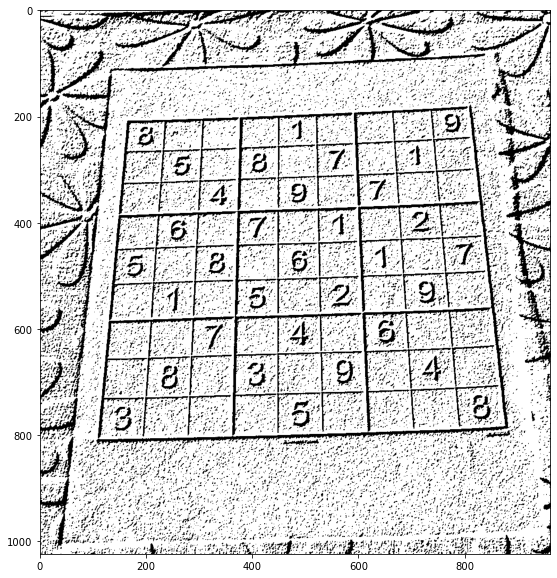

In [116]:
ret,th1 = cv2.threshold(blended,100,255,cv2.THRESH_BINARY_INV)
display_img(th1)

In [117]:
dark_horse = cv2.imread('../DATA/horse.jpg')
show_horse = cv2.cvtColor(dark_horse, cv2.COLOR_BGR2RGB)

rainbow = cv2.imread('../DATA/rainbow.jpg')
show_rainbow =cv2.cvtColor(rainbow, cv2.COLOR_BGR2RGB)

blue_bricks = cv2.imread('../DATA/bricks.jpg')
show_bricks = cv2.cvtColor(blue_bricks, cv2.COLOR_BGR2RGB)

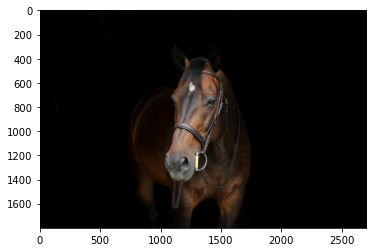

In [118]:
plt.imshow(show_horse)

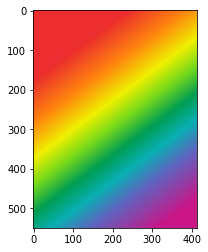

In [119]:
plt.imshow(show_rainbow)

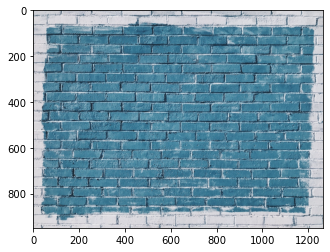

In [120]:
plt.imshow(show_bricks)

### OpenCV Histogram

**cv2.calcHist(images, channels, mask, histSize, ranges[, hist[, accumulate]])**

* images : it is the source image of type uint8 or float32. it should be given in square brackets, ie, “[img]”.
* channels : it is also given in square brackets. It is the index of channel for which we calculate histogram. For example, if input is grayscale image, its value is [0]. For color image, you can pass [0], [1] or [2] to calculate histogram of blue, green or red channel respectively.
* mask : mask image. To find histogram of full image, it is given as “None”. But if you want to find histogram of particular region of image, you have to create a mask image for that and give it as mask. (I will show an example later.)
* histSize : this represents our BIN count. Need to be given in square brackets. For full scale, we pass [256].
* ranges : this is our RANGE. Normally, it is [0,256].

In [121]:
hist_values = cv2.calcHist([blue_bricks],channels=[0],mask=None,histSize=[256],ranges=[0,256])
hist_values.shape

(256, 1)

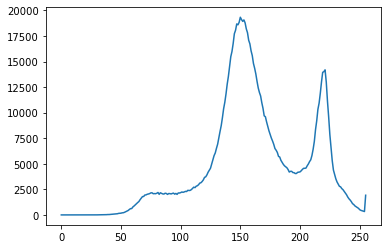

In [122]:
plt.plot(hist_values)

In [123]:
hist_values = cv2.calcHist([dark_horse],channels=[0],mask=None,histSize=[256],ranges=[0,256])

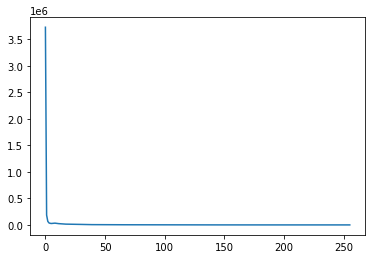

In [124]:
plt.plot(hist_values)

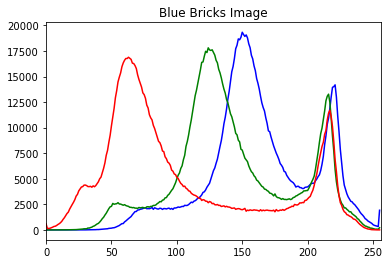

In [125]:
img = blue_bricks
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv2.calcHist([img],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.title('Blue Bricks Image')
plt.show()

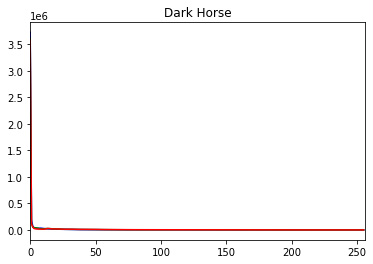

In [126]:
img = dark_horse
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv2.calcHist([img],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.title('Dark Horse')
plt.show()

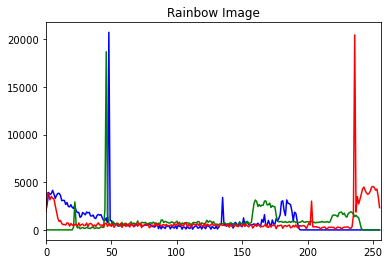

In [127]:
img = rainbow
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv2.calcHist([img],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.title('Rainbow Image')
plt.show()

In [128]:
img = rainbow
img.shape

(550, 413, 3)

In [129]:
# create a mask
mask = np.zeros(img.shape[:2], np.uint8)
mask[300:400, 100:400] = 255

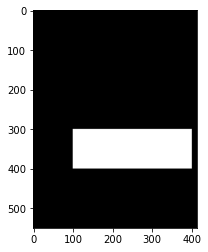

In [130]:
plt.imshow(mask,cmap='gray')

In [131]:
masked_img = cv2.bitwise_and(img,img,mask = mask)
show_masked_img = cv2.bitwise_and(show_rainbow,show_rainbow,mask = mask)

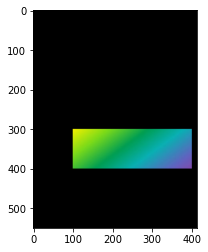

In [132]:
plt.imshow(show_masked_img)

In [133]:
hist_mask_values_red = cv2.calcHist([rainbow],channels=[2],mask=mask,histSize=[256],ranges=[0,256])
hist_full_values_red = cv2.calcHist([rainbow],channels=[2],mask=None,histSize=[256],ranges=[0,256])

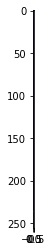

In [134]:
plt.imshow(hist_full_values_red)

Text(0.5, 1.0, 'Histogram for RED values of the full image')

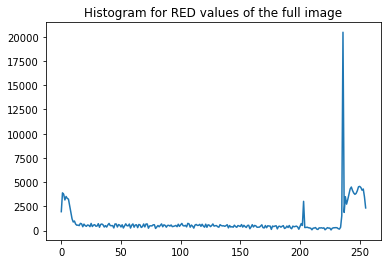

In [135]:
plt.plot(hist_full_values_red)
plt.title('Histogram for RED values of the full image')

Text(0.5, 1.0, 'Histogram for RED values for the Masked Area')

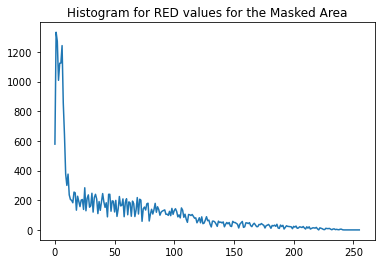

In [136]:
plt.plot(hist_mask_values_red)
plt.title('Histogram for RED values for the Masked Area')

In [137]:
gorilla = cv2.imread('../DATA/gorilla.jpg',0)

In [138]:
def display(img,cmap=None):
    fig = plt.figure(figsize=(10,8))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap)

## Single Channel (Grayscale)

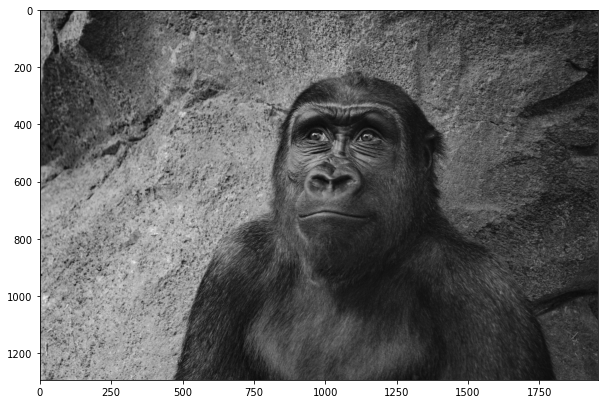

In [139]:
display(gorilla,cmap='gray')

In [140]:
hist_values = cv2.calcHist([gorilla],channels=[0],mask=None,histSize=[256],ranges=[0,256])

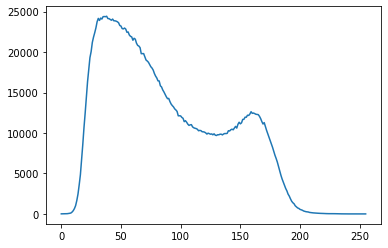

In [141]:
plt.plot(hist_values)

In [142]:
eq_gorilla = cv2.equalizeHist(gorilla)

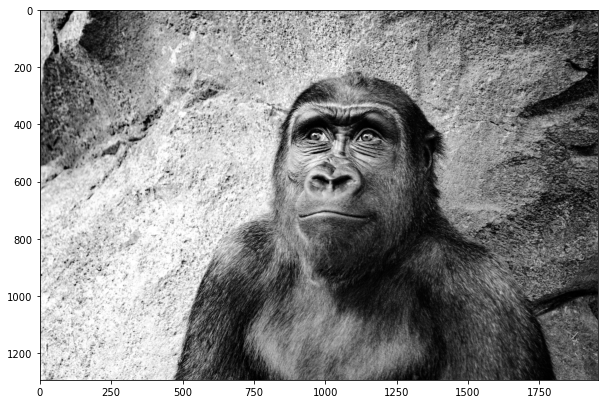

In [143]:
display(eq_gorilla,cmap='gray')

In [144]:
hist_values = cv2.calcHist([eq_gorilla],channels=[0],mask=None,histSize=[256],ranges=[0,256])

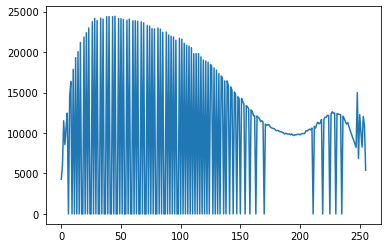

In [145]:
plt.plot(hist_values)

In [146]:
color_gorilla = cv2.imread('../DATA/gorilla.jpg')
show_gorilla = cv2.cvtColor(color_gorilla,cv2.COLOR_BGR2RGB)
# Convert to HSV colorspace
hsv = cv2.cvtColor(color_gorilla, cv2.COLOR_BGR2HSV)

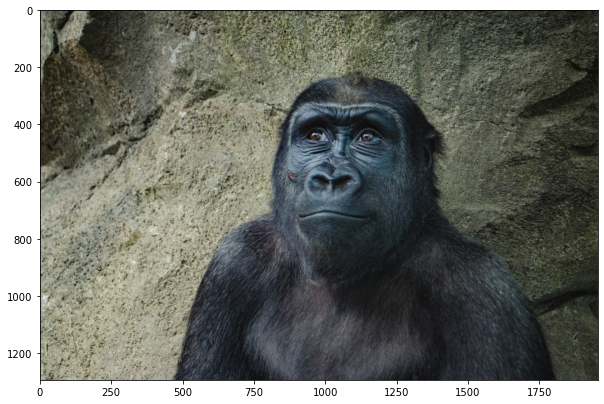

In [147]:
display(show_gorilla)

In [148]:
# Grab V channel
hsv[:,:,2]

array([[127, 121, 115, ...,  43,  42,  42],
       [121, 124, 123, ...,  47,  49,  51],
       [118, 129, 131, ...,  47,  50,  53],
       ...,
       [196, 198, 185, ...,  55,  55,  55],
       [184, 185, 182, ...,  51,  52,  53],
       [174, 170, 173, ...,  49,  50,  50]], dtype=uint8)

In [149]:
hsv[:,:,2] = cv2.equalizeHist(hsv[:,:,2])

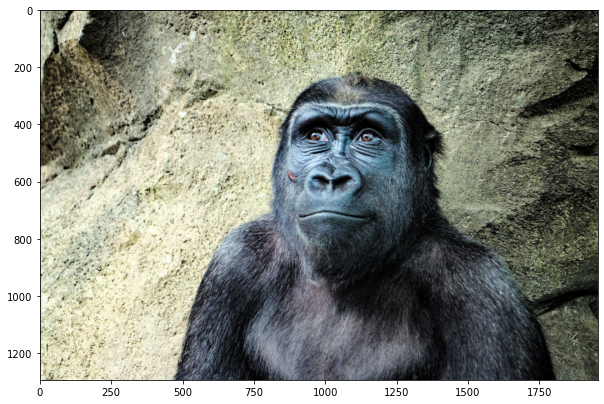

In [150]:
# Convert back to RGB to visualize
eq_color_gorilla = cv2.cvtColor(hsv, cv2.COLOR_HSV2RGB)
display(eq_color_gorilla)

In [3]:
import numpy as np
import cv2 as cv

def nothing(x):
    print(x)

# Create a black image, a window
cv.namedWindow('image')

cv.createTrackbar('CP', 'image', 10, 400, nothing)

switch = 'color/gray'
cv.createTrackbar(switch, 'image', 0, 1, nothing)

while(1):
    img = cv.imread('../DATA/Nadia_Murad.jpg')
    pos = cv.getTrackbarPos('CP', 'image')
    font = cv.FONT_HERSHEY_SIMPLEX
    cv.putText(img, str(pos), (50, 150), font, 6, (0, 0, 255), 10)

    k = cv.waitKey(1) & 0xFF
    if k == 27:
        break

    s = cv.getTrackbarPos(switch, 'image')

    if s == 0:
       pass
    else:
       img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

    img = cv.imshow('image',img)

cv.destroyAllWindows()

8
7
6
4
3
1
0
1
3
4
6
7
8
10
13
14
16
18
21
23
24
27
28
31
33
35
38
41
44
48
51
52
54
55
57
58
59
61
62
64
65
66
68
69
149


In [1]:
import cv2
import numpy as np

def nothing(x):
    pass

cv2.namedWindow("Tracking")
cv2.createTrackbar("LH", "Tracking", 0, 255, nothing)
cv2.createTrackbar("LS", "Tracking", 0, 255, nothing)
cv2.createTrackbar("LV", "Tracking", 0, 255, nothing)
cv2.createTrackbar("UH", "Tracking", 255, 255, nothing)
cv2.createTrackbar("US", "Tracking", 255, 255, nothing)
cv2.createTrackbar("UV", "Tracking", 255, 255, nothing)

while True:
    frame = cv2.imread('../DATA/crossword.jpg')

    hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

    l_h = cv2.getTrackbarPos("LH", "Tracking")
    l_s = cv2.getTrackbarPos("LS", "Tracking")
    l_v = cv2.getTrackbarPos("LV", "Tracking")

    u_h = cv2.getTrackbarPos("UH", "Tracking")
    u_s = cv2.getTrackbarPos("US", "Tracking")
    u_v = cv2.getTrackbarPos("UV", "Tracking")

    l_b = np.array([l_h, l_s, l_v])
    u_b = np.array([u_h, u_s, u_v])

    mask = cv2.inRange(hsv, l_b, u_b)

    res = cv2.bitwise_and(frame, frame, mask=mask)

    cv2.imshow("frame", frame)
    cv2.imshow("mask", mask)
    cv2.imshow("res", res)

    key = cv2.waitKey(1)
    if key == 27:
        break

cv2.destroyAllWindows()

In [14]:
import numpy as np
import cv2

img = cv2.imread('../DATA/coins_on_white.jpg')
imgray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
ret, thresh = cv2.threshold(imgray, 127, 255, 0)
contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
print("Number of contours = " + str(len(contours)))
print(contours[0])
a=cv2.resize(img,(400,400))
b=cv2.resize(imgray,(400,400))
cv2.drawContours(a, contours, -1, (0, 255, 0), 3)
cv2.drawContours(b, contours, -1, (0, 255, 0), 3)

cv2.imshow('Image', a)
cv2.imshow('Image GRAY', b)
cv2.waitKey(0)
cv2.destroyAllWindows()

Number of contours = 10603
[[[0 0]]

 [[0 1]]

 [[0 2]]

 ...

 [[3 0]]

 [[2 0]]

 [[1 0]]]


In [2]:
import numpy as np
import cv2 as cv

img = cv.imread('../DATA/Logo.jpg')

gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

corners = cv.goodFeaturesToTrack(gray, 100, 0.01, 10)

corners = np.int0(corners)

for i in corners:
    x, y = i.ravel()
    cv.circle(img, (x, y), 3, [255, 255, 0], -1)

cv.imshow('Shi-Tomasi Corner Detector', img)

if cv.waitKey(0) & 0xff == 27:
    cv.destroyAllWindows()